In [2]:
import os
import pandas as pd
import numpy as np

# Load data set

In [3]:
LATEST_DATA_URL = 'https://raw.githubusercontent.com/OxCGRT/covid-policy-tracker/master/data/OxCGRT_latest.csv'
GEO_FILE = "countries_regions.csv"

In [4]:
LATEST_DATA_PATH="D:\dev\covid-xprize\covid_xprize\examples\predictors\lstm\data\OxCGRT_latest.csv"

In [5]:
from covid_xprize.scoring.predictor_scoring import load_dataset
latest_df = load_dataset(LATEST_DATA_PATH, GEO_FILE)

In [6]:
latest_df.sample(3)

,CountryName,CountryCode,RegionName,RegionCode,Jurisdiction,Date,C1_School closing,C1_Flag,C2_Workplace closing,C2_Flag,...,StringencyIndex,StringencyIndexForDisplay,StringencyLegacyIndex,StringencyLegacyIndexForDisplay,GovernmentResponseIndex,GovernmentResponseIndexForDisplay,ContainmentHealthIndex,ContainmentHealthIndexForDisplay,EconomicSupportIndex,EconomicSupportIndexForDisplay
51209,Lithuania,LTU,,NaN,NAT_TOTAL,2020-06-07,1.0,1.0,2.0,1.0,...,56.48,56.48,71.43,71.43,55.00,55.00,51.92,51.92,75.0,75.0
61023,Pakistan,PAK,,NaN,NAT_TOTAL,2020-11-29,3.0,1.0,3.0,0.0,...,64.35,64.35,68.57,68.57,66.39,66.39,65.06,65.06,75.0,75.0
92900,United States,USA,South Dakota,US_SD,STATE_TOTAL,2020-03-21,3.0,1.0,2.0,1.0,...,49.07,49.07,69.05,69.05,38.33,38.33,40.38,40.38,25.0,25.0


In [7]:
# Expecting 180 countries
len(latest_df.CountryName.unique())

180

In [8]:
# Expecting 56 regions, plus the empty one '' = 57
len(latest_df.RegionName.unique())

57

# Dates

In [33]:
start_date_str = "2020-11-01"
end_date_str = "2020-11-30"

In [34]:
start_date = pd.to_datetime(start_date_str, format='%Y-%m-%d')
end_date = pd.to_datetime(end_date_str, format='%Y-%m-%d')

# Get actual cases between these dates

In [35]:
NUM_PREV_DAYS_TO_INCLUDE = 6
WINDOW_SIZE = 7

In [36]:
def get_actual_cases(df, start_date, end_date):
    # 1 day earlier to compute the daily diff
    start_date_for_diff = start_date - pd.offsets.Day(WINDOW_SIZE)
    actual_df = df[["CountryName", "RegionName", "Date", "ConfirmedCases"]]
    # Filter out the data set to include all the data needed to compute the diff
    actual_df = actual_df[(actual_df.Date >= start_date_for_diff) & (actual_df.Date <= end_date)]
    # Add GeoID column that combines CountryName and RegionName for easier manipulation of data
    # np.where usage: if A then B else C
    actual_df["GeoID"] = np.where(actual_df["RegionName"] == '',
                                  actual_df["CountryName"],
                                  actual_df["CountryName"] + ' / ' + actual_df["RegionName"])
    actual_df.sort_values(by=["GeoID","Date"], inplace=True)
    # Compute the diff
    actual_df["ActualDailyNewCases"] = actual_df.groupby("GeoID")["ConfirmedCases"].diff()
    # Compute the 7 day moving average
    actual_df["ActualDailyNewCases7DMA"] = actual_df.groupby(
        "GeoID")['ActualDailyNewCases'].rolling(
        WINDOW_SIZE, center=False).mean().reset_index(0, drop=True)
    return actual_df

In [37]:
actual_df = get_actual_cases(latest_df, start_date, end_date)

In [38]:
# Add population column.
from covid_xprize.scoring.predictor_scoring import add_population_column

actual_df = add_population_column(actual_df)

In [39]:
actual_df.head(12)

,CountryName,RegionName,Date,ConfirmedCases,GeoID,ActualDailyNewCases,ActualDailyNewCases7DMA,Population
0,Afghanistan,,2020-10-25,40833.0,Afghanistan,NaN,NaN,38928346
1,Afghanistan,,2020-10-26,40937.0,Afghanistan,104.0,NaN,38928346
2,Afghanistan,,2020-10-27,41032.0,Afghanistan,95.0,NaN,38928346
3,Afghanistan,,2020-10-28,41145.0,Afghanistan,113.0,NaN,38928346
4,Afghanistan,,2020-10-29,41268.0,Afghanistan,123.0,NaN,38928346
5,Afghanistan,,2020-10-30,41334.0,Afghanistan,66.0,NaN,38928346
6,Afghanistan,,2020-10-31,41425.0,Afghanistan,91.0,NaN,38928346
7,Afghanistan,,2020-11-01,41501.0,Afghanistan,76.0,95.428571,38928346
8,Afghanistan,,2020-11-02,41633.0,Afghanistan,132.0,99.428571,38928346
9,Afghanistan,,2020-11-03,41728.0,Afghanistan,95.0,99.428571,38928346


In [40]:
ID_COLS = ['CountryName',
           'RegionName',
           'Date']

In [41]:
# Add empty rows until end date, if needed, to simplify merge with teams predictions
new_rows = []
for g in actual_df.GeoID.unique():
    gdf = actual_df[actual_df.GeoID == g]
    last_known_date = gdf.Date.max()
    current_date = last_known_date + np.timedelta64(1, 'D')
    while current_date <= end_date:
        new_row = [gdf.CountryName.unique()[0],
                   gdf.RegionName.unique()[0],
                   current_date,
                   np.nan,
                   g,
                   np.nan,
                   np.nan,
                   gdf.Population.unique()[0]
                  ]
        new_rows.append(new_row)
        # Move to next day
        current_date = current_date + np.timedelta64(1, 'D')
# Add the new rows
if new_rows:
    new_rows_df = pd.DataFrame(new_rows, columns=actual_df.columns)
    # Append the new rows
    actual_df = actual_df.append(new_rows_df)
# Sort
actual_df.sort_values(by=ID_COLS, inplace=True, ignore_index=True)

In [42]:
actual_df.head(40)

,CountryName,RegionName,Date,ConfirmedCases,GeoID,ActualDailyNewCases,ActualDailyNewCases7DMA,Population
0,Afghanistan,,2020-10-25,40833.0,Afghanistan,NaN,NaN,38928346
1,Afghanistan,,2020-10-26,40937.0,Afghanistan,104.0,NaN,38928346
2,Afghanistan,,2020-10-27,41032.0,Afghanistan,95.0,NaN,38928346
3,Afghanistan,,2020-10-28,41145.0,Afghanistan,113.0,NaN,38928346
4,Afghanistan,,2020-10-29,41268.0,Afghanistan,123.0,NaN,38928346
5,Afghanistan,,2020-10-30,41334.0,Afghanistan,66.0,NaN,38928346
6,Afghanistan,,2020-10-31,41425.0,Afghanistan,91.0,NaN,38928346
7,Afghanistan,,2020-11-01,41501.0,Afghanistan,76.0,95.428571,38928346
8,Afghanistan,,2020-11-02,41633.0,Afghanistan,132.0,99.428571,38928346
9,Afghanistan,,2020-11-03,41728.0,Afghanistan,95.0,99.428571,38928346


# Get historical data for 7 days moving average calculation
In order to compute the 7 days moving average, we need to get the historical true new cases for the last 7 days before start date

In [43]:
ma_df = actual_df[actual_df["Date"] < start_date]
ma_df = ma_df[["CountryName", "RegionName", "Date", "ActualDailyNewCases"]]
ma_df = ma_df.rename(columns={"ActualDailyNewCases": "PredictedDailyNewCases"})
ma_df.head()

,CountryName,RegionName,Date,PredictedDailyNewCases
0,Afghanistan,,2020-10-25,NaN
1,Afghanistan,,2020-10-26,104.0
2,Afghanistan,,2020-10-27,95.0
3,Afghanistan,,2020-10-28,113.0
4,Afghanistan,,2020-10-29,123.0


# Run the predictions
Evaluate some example submissions.  
__NOTE: Please run the corresponding example notebooks first in order to train the models that are used in this section.__

In [50]:
IP_FILE = "covid_xprize/validation/data/2020-12-16_historical_ip.csv"
predictions = {}

In [45]:
from covid_xprize.validation.scenario_generator import generate_scenario

countries = None
scenario_df = generate_scenario(start_date_str, end_date_str, latest_df, countries, scenario="Freeze")
scenario_df.to_csv(IP_FILE, index=False)

## Linear

In [ ]:
# Check a model has been trained
if not os.path.isfile("covid_xprize/examples/predictors/linear/models/model.pkl"):
    print("ERROR: Please run the notebook in 'covid_xprize/examples/predictors/linear' in order to train a model!")

In [ ]:
linear_output_file = "covid_xprize/examples/predictors/linear/predictions/robojudge_test.csv"

In [ ]:
!python covid_xprize/examples/predictors/linear/predict.py -s {start_date_str} -e {end_date_str} -ip {IP_FILE} -o {linear_output_file}

In [ ]:
predictions["Linear"] = linear_output_file

## LSTM

In [ ]:
# Check a model has been trained
if not os.path.isfile("covid_xprize/examples/predictors/lstm/models/trained_model_weights.h5"):
    print("ERROR: Please run the notebook in 'covid_xprize/examples/predictors/lstm' in order to train a model!")

In [ ]:
lstm_output_file = "covid_xprize/examples/predictors/lstm/predictions/robojudge_test.csv"

In [ ]:
!python covid_xprize/examples/predictors/lstm/predict.py -s {start_date_str} -e {end_date_str} -ip {IP_FILE} -o {lstm_output_file}

In [ ]:
predictions["LSTM"] = lstm_output_file

## LSTM NORM

In [82]:
lstm_output_file = "covid_xprize/examples/predictors/lstm/predictions/val_4_days.csv"

In [114]:
!D:\dev\covid-xprize\venv\Scripts\python.exe covid_xprize/examples/predictors/lstm/predict.py -s {start_date_str} -e {end_date_str} -ip {IP_FILE} -o {lstm_output_file}

Generating predictions from 2020-11-01 to 2020-11-30...
Saved predictions to covid_xprize/examples/predictors/lstm/predictions/val_4_days.csv
Done!


In [83]:
predictions["BaselineLSTM"] = lstm_output_file

## March Norm LSTM 

In [51]:
init_march_norm_lstm_output_file = "covid_xprize/examples/predictors/lstm/predictions/init_march_norm_preds.csv"

In [148]:
!D:\dev\covid-xprize\venv\Scripts\python.exe covid_xprize/examples/predictors/lstm/custom_predict.py -s {start_date_str} -e {end_date_str} -ip {IP_FILE} -o {init_march_norm_lstm_output_file}

Generating predictions from 2020-11-01 to 2020-11-30...
Loading D:\dev\covid-xprize\covid_xprize\examples\predictors\lstm\models\norm_lstm_5_32_21_30_0.2.h5 model
Saved predictions to covid_xprize/examples/predictors/lstm/predictions/init_march_norm_preds.csv
Done!


In [52]:
predictions["InitMarchNorm"] = init_march_norm_lstm_output_file

## Init MId March Norm LSTM 

In [109]:
init_mid_march_norm_lstm_output_file = "covid_xprize/examples/predictors/lstm/predictions/init_mid_march_norm_preds.csv"

In [110]:
!D:\dev\covid-xprize\venv\Scripts\python.exe covid_xprize/examples/predictors/lstm/custom_predict.py -s {start_date_str} -e {end_date_str} -ip {IP_FILE} -o {init_mid_march_norm_lstm_output_file}

Generating predictions from 2020-11-01 to 2020-11-30...
Loading D:\dev\covid-xprize\covid_xprize\examples\predictors\lstm\models\mid_march_norm_lstm_5_32_21_30_d20.h5 model
Saved predictions to covid_xprize/examples/predictors/lstm/predictions/init_mid_march_norm_preds.csv
Done!


In [111]:
predictions["InitMidMarchNorm"] = init_march_norm_lstm_output_file

## Init April Norm LSTM 

In [137]:
init_april_norm_lstm_output_file = "covid_xprize/examples/predictors/lstm/predictions/init_april_norm_preds.csv"

In [138]:
!D:\dev\covid-xprize\venv\Scripts\python.exe covid_xprize/examples/predictors/lstm/custom_predict.py -s {start_date_str} -e {end_date_str} -ip {IP_FILE} -o {init_april_norm_lstm_output_file}

Generating predictions from 2020-11-01 to 2020-11-30...
Loading D:\dev\covid-xprize\covid_xprize\examples\predictors\lstm\models\mid_march_norm_lstm_5_32_21_30_d20.h5 model
Saved predictions to covid_xprize/examples/predictors/lstm/predictions/init_april_norm_preds.csv
Done!


In [140]:
predictions["InitAprilNorm"] = init_april_norm_lstm_output_file

## Init March Holiday Norm LSTM 

In [168]:
init_march_holiday_norm_lstm_output_file = "covid_xprize/examples/predictors/lstm/predictions/init_march_holiday_norm_preds.csv"

In [172]:
!D:\dev\covid-xprize\venv\Scripts\python.exe covid_xprize/examples/predictors/lstm/custom_holiday_predict.py -s {start_date_str} -e {end_date_str} -ip {IP_FILE} -o {init_march_holiday_norm_lstm_output_file}

Generating predictions from 2020-11-01 to 2020-11-30...
Loading D:\dev\covid-xprize\covid_xprize\examples\predictors\lstm\models\mid_march_norm_lstm_5_32_21_30_d20.h5 model
Saved predictions to covid_xprize/examples/predictors/lstm/predictions/init_march_holiday_norm_preds.csv
Done!
^C


In [174]:
predictions["InitMarchHolidayNorm"] = init_march_holiday_norm_lstm_output_file

## Average March Holiday + March Norm

In [241]:
holiday_df = pd.read_csv(predictions["InitMarchHolidayNorm"] )
march_df = pd.read_csv(predictions["InitMarchNorm"])
april_df = pd.read_csv(predictions["InitAprilNorm"])


In [242]:
holiday_df.head()

,CountryName,RegionName,Date,PredictedDailyNewCases
0,Afghanistan,NaN,2020-11-01,178.156876
1,Afghanistan,NaN,2020-11-02,262.442472
2,Afghanistan,NaN,2020-11-03,173.013013
3,Afghanistan,NaN,2020-11-04,188.613247
4,Afghanistan,NaN,2020-11-05,203.317340


In [249]:
holiday_df.merge(march_df, on =["CountryName", "RegionName","Date"]).merge(april_df, on =["CountryName", "RegionName","Date"] ).mean(axis=1)

0       201.867714
1       266.334410
2       219.547088
3       228.800167
4       255.248144
           ...    
7075    167.770293
7076     87.330910
7077    141.644932
7078     98.635217
7079    135.739897
Length: 7080, dtype: float64

In [250]:
holiday_norm_df = holiday_df.merge(march_df, on =["CountryName", "RegionName","Date"]).merge(april_df, on =["CountryName", "RegionName","Date"] )

In [251]:
holiday_norm_df['PredictedDailyNewCases'] = holiday_norm_df.mean(axis=1)

In [252]:
holiday_norm_df.head()

,CountryName,RegionName,Date,PredictedDailyNewCases_x,PredictedDailyNewCases_y,PredictedDailyNewCases
0,Afghanistan,NaN,2020-11-01,178.156876,211.038038,201.867714
1,Afghanistan,NaN,2020-11-02,262.442472,277.039163,266.334410
2,Afghanistan,NaN,2020-11-03,173.013013,250.680477,219.547088
3,Afghanistan,NaN,2020-11-04,188.613247,254.316342,228.800167
4,Afghanistan,NaN,2020-11-05,203.317340,292.376632,255.248144


In [253]:
holiday_norm_df.to_csv("covid_xprize/examples/predictors/lstm/predictions/init_march_norm_holiday_mean_preds.csv")

In [255]:
predictions["MarchNormPlusHolidayAvg"] = "covid_xprize/examples/predictors/lstm/predictions/init_march_norm_holiday_mean_preds.csv"

# Get predictions from submissions

In [256]:
def get_predictions_from_file(predictor_name, predictions_file, ma_df):
    preds_df = pd.read_csv(predictions_file,
                           parse_dates=['Date'],
                           encoding="ISO-8859-1",
                           error_bad_lines=False)
    preds_df["RegionName"] = preds_df["RegionName"].fillna("")
    preds_df["PredictorName"] = predictor_name
    preds_df["Prediction"] = True
    
    # Append the true number of cases before start date
    ma_df["PredictorName"] = predictor_name
    ma_df["Prediction"] = False
    preds_df = ma_df.append(preds_df, ignore_index=True)

    # Add GeoID column that combines CountryName and RegionName for easier manipulation of data
    # np.where usage: if A then B else C
    preds_df["GeoID"] = np.where(preds_df["RegionName"] == '',
                                 preds_df["CountryName"],
                                 preds_df["CountryName"] + ' / ' + preds_df["RegionName"])
    # Sort
    preds_df.sort_values(by=["GeoID","Date"], inplace=True)
    # Compute the 7 days moving average for PredictedDailyNewCases
    preds_df["PredictedDailyNewCases7DMA"] = preds_df.groupby(
        "GeoID")['PredictedDailyNewCases'].rolling(
        WINDOW_SIZE, center=False).mean().reset_index(0, drop=True)

    # Put PredictorName first
    preds_df = preds_df[["PredictorName"] + [col for col in preds_df.columns if col != "PredictorName"]]
    return preds_df

In [257]:
test_predictor_name = "InitMarchNorm"
temp_df = get_predictions_from_file(test_predictor_name, predictions[test_predictor_name], ma_df.copy())
temp_df.head(12)

,PredictorName,CountryName,RegionName,Date,PredictedDailyNewCases,Prediction,GeoID,PredictedDailyNewCases7DMA
0,InitMarchNorm,Afghanistan,,2020-10-25,NaN,False,Afghanistan,NaN
1,InitMarchNorm,Afghanistan,,2020-10-26,104.000000,False,Afghanistan,NaN
2,InitMarchNorm,Afghanistan,,2020-10-27,95.000000,False,Afghanistan,NaN
3,InitMarchNorm,Afghanistan,,2020-10-28,113.000000,False,Afghanistan,NaN
4,InitMarchNorm,Afghanistan,,2020-10-29,123.000000,False,Afghanistan,NaN
5,InitMarchNorm,Afghanistan,,2020-10-30,66.000000,False,Afghanistan,NaN
6,InitMarchNorm,Afghanistan,,2020-10-31,91.000000,False,Afghanistan,NaN
1682,InitMarchNorm,Afghanistan,,2020-11-01,211.038038,True,Afghanistan,114.719720
1683,InitMarchNorm,Afghanistan,,2020-11-02,277.039163,True,Afghanistan,139.439600
1684,InitMarchNorm,Afghanistan,,2020-11-03,250.680477,True,Afghanistan,161.679668


In [258]:
actual_df.head(8)

,CountryName,RegionName,Date,ConfirmedCases,GeoID,ActualDailyNewCases,ActualDailyNewCases7DMA,Population
0,Afghanistan,,2020-10-25,40833.0,Afghanistan,NaN,NaN,38928346
1,Afghanistan,,2020-10-26,40937.0,Afghanistan,104.0,NaN,38928346
2,Afghanistan,,2020-10-27,41032.0,Afghanistan,95.0,NaN,38928346
3,Afghanistan,,2020-10-28,41145.0,Afghanistan,113.0,NaN,38928346
4,Afghanistan,,2020-10-29,41268.0,Afghanistan,123.0,NaN,38928346
5,Afghanistan,,2020-10-30,41334.0,Afghanistan,66.0,NaN,38928346
6,Afghanistan,,2020-10-31,41425.0,Afghanistan,91.0,NaN,38928346
7,Afghanistan,,2020-11-01,41501.0,Afghanistan,76.0,95.428571,38928346


In [259]:
from covid_xprize.validation.predictor_validation import validate_submission

ranking_df = pd.DataFrame()
for predictor_name, predictions_file in predictions.items():
    print(f"Getting {predictor_name}'s predictions from: {predictions_file}")
    errors = validate_submission(start_date_str, end_date_str, IP_FILE, predictions_file)
    if not errors:
        preds_df = get_predictions_from_file(predictor_name, predictions_file, ma_df)
        merged_df = actual_df.merge(preds_df, on=['CountryName', 'RegionName', 'Date', 'GeoID'], how='left')
        ranking_df = ranking_df.append(merged_df)
    else:
        print(f"Predictor {predictor_name} did not submit valid predictions! Please check its errors:")
        print(errors)

Getting InitMarchNorm's predictions from: covid_xprize/examples/predictors/lstm/predictions/init_march_norm_preds.csv
Getting BaselineLSTM's predictions from: covid_xprize/examples/predictors/lstm/predictions/val_4_days.csv
Getting InitMidMarchNorm's predictions from: covid_xprize/examples/predictors/lstm/predictions/init_march_norm_preds.csv
Getting InitAprilNorm's predictions from: covid_xprize/examples/predictors/lstm/predictions/init_april_norm_preds.csv
Getting InitMarchHolidayNorm's predictions from: covid_xprize/examples/predictors/lstm/predictions/init_march_holiday_norm_preds.csv
Getting MarchNormPlusHolidayAvg's predictions from: covid_xprize/examples/predictors/lstm/predictions/init_march_norm_holiday_mean_preds.csv


In [260]:
# Keep only predictions (either Prediction == True) or on or after start_date
ranking_df = ranking_df[ranking_df["Date"] >= start_date]

In [261]:
from covid_xprize.scoring.predictor_scoring import add_predictor_performance_columns

# Compute performance measures
ranking_df = add_predictor_performance_columns(ranking_df)

In [262]:
ranking_df.head(4*2)

,CountryName,RegionName,Date,ConfirmedCases,GeoID,ActualDailyNewCases,ActualDailyNewCases7DMA,Population,PredictorName,PredictedDailyNewCases,Prediction,PredictedDailyNewCases7DMA,Unnamed: 0,PredictedDailyNewCases_x,PredictedDailyNewCases_y,DiffDaily,Diff7DMA,CumulDiff7DMA,Cumul-7DMA-MAE-per-100K,PredictorRank
7,Afghanistan,,2020-11-01,41501.0,Afghanistan,76.0,95.428571,38928346,InitMarchHolidayNorm,178.156876,True,110.022411,NaN,NaN,NaN,102.156876,14.593839,14.593839,0.037489,1.0
7,Afghanistan,,2020-11-01,41501.0,Afghanistan,76.0,95.428571,38928346,MarchNormPlusHolidayAvg,201.867714,True,113.409673,0.0,178.156876,211.038038,125.867714,17.981102,17.981102,0.046190,2.0
7,Afghanistan,,2020-11-01,41501.0,Afghanistan,76.0,95.428571,38928346,InitMarchNorm,211.038038,True,114.719720,NaN,NaN,NaN,135.038038,19.291148,19.291148,0.049556,3.5
7,Afghanistan,,2020-11-01,41501.0,Afghanistan,76.0,95.428571,38928346,InitMidMarchNorm,211.038038,True,114.719720,NaN,NaN,NaN,135.038038,19.291148,19.291148,0.049556,3.5
7,Afghanistan,,2020-11-01,41501.0,Afghanistan,76.0,95.428571,38928346,InitAprilNorm,216.408228,True,115.486890,NaN,NaN,NaN,140.408228,20.058318,20.058318,0.051526,5.0
7,Afghanistan,,2020-11-01,41501.0,Afghanistan,76.0,95.428571,38928346,BaselineLSTM,227.483726,True,117.069104,NaN,NaN,NaN,151.483726,21.640532,21.640532,0.055591,6.0
8,Afghanistan,,2020-11-02,41633.0,Afghanistan,132.0,99.428571,38928346,InitMarchHolidayNorm,262.442472,True,132.657050,NaN,NaN,NaN,130.442472,33.228478,47.822318,0.122847,1.0
8,Afghanistan,,2020-11-02,41633.0,Afghanistan,132.0,99.428571,38928346,MarchNormPlusHolidayAvg,266.334410,True,136.600303,1.0,262.442472,277.039163,134.334410,37.171732,55.152834,0.141678,2.0


In [263]:
ranking_df[(ranking_df.CountryName == "United States") &
           (ranking_df.Date == '2020-12-02')]

,CountryName,RegionName,Date,ConfirmedCases,GeoID,ActualDailyNewCases,ActualDailyNewCases7DMA,Population,PredictorName,PredictedDailyNewCases,Prediction,PredictedDailyNewCases7DMA,Unnamed: 0,PredictedDailyNewCases_x,PredictedDailyNewCases_y,DiffDaily,Diff7DMA,CumulDiff7DMA,Cumul-7DMA-MAE-per-100K,PredictorRank


In [264]:
# Save to file
# ranking_df.to_csv("/Users/m_754337/workspace/esp-demo/xprize/tests/fixtures/ranking.csv", index=False)

# Ranking

In [265]:
# Filter to get the metrics for the final day
last_known_date = ranking_df[ranking_df["Cumul-7DMA-MAE-per-100K"].notnull()].Date.max()
leaderboard_df = ranking_df[ranking_df.Date == last_known_date][[
        "CountryName",
        "RegionName",
        "PredictorName",
        "Cumul-7DMA-MAE-per-100K",
        "PredictorRank"]]

## Global

In [266]:
leaderboard_df.groupby(["PredictorName"]).mean() \
    .sort_values(by=["Cumul-7DMA-MAE-per-100K"]).reset_index()

,PredictorName,Cumul-7DMA-MAE-per-100K,PredictorRank
0,InitMarchNorm,361.732202,3.125000
1,InitMidMarchNorm,361.732202,3.125000
2,InitAprilNorm,366.183072,3.319915
3,MarchNormPlusHolidayAvg,370.132575,3.177966
4,BaselineLSTM,393.394486,3.766949
5,InitMarchHolidayNorm,474.310391,4.485169


## Countries

In [267]:
leaderboard_df.sort_values(by=['CountryName', 'RegionName'])

,CountryName,RegionName,PredictorName,Cumul-7DMA-MAE-per-100K,PredictorRank
36,Afghanistan,,MarchNormPlusHolidayAvg,5.045655,1.0
36,Afghanistan,,InitAprilNorm,7.195059,2.0
36,Afghanistan,,InitMarchHolidayNorm,7.951982,3.0
36,Afghanistan,,BaselineLSTM,10.665954,4.0
36,Afghanistan,,InitMarchNorm,13.470500,5.5
...,...,...,...,...,...
8731,Zimbabwe,,InitMarchNorm,12.019635,2.5
8731,Zimbabwe,,InitMidMarchNorm,12.019635,2.5
8731,Zimbabwe,,MarchNormPlusHolidayAvg,12.256045,4.0
8731,Zimbabwe,,InitAprilNorm,25.902245,5.0


## Specific country

In [268]:
leaderboard_df[(leaderboard_df.CountryName == "Italy") &
               (leaderboard_df.RegionName == "")]

,CountryName,RegionName,PredictorName,Cumul-7DMA-MAE-per-100K,PredictorRank
3107,Italy,,InitMarchNorm,551.672980,1.5
3107,Italy,,InitMidMarchNorm,551.672980,1.5
3107,Italy,,InitAprilNorm,818.910952,3.0
3107,Italy,,MarchNormPlusHolidayAvg,848.727423,4.0
3107,Italy,,BaselineLSTM,964.946946,5.0
3107,Italy,,InitMarchHolidayNorm,1175.598336,6.0


In [269]:
ranking_df[ranking_df.CountryName == "Italy"]

,CountryName,RegionName,Date,ConfirmedCases,GeoID,ActualDailyNewCases,ActualDailyNewCases7DMA,Population,PredictorName,PredictedDailyNewCases,Prediction,PredictedDailyNewCases7DMA,Unnamed: 0,PredictedDailyNewCases_x,PredictedDailyNewCases_y,DiffDaily,Diff7DMA,CumulDiff7DMA,Cumul-7DMA-MAE-per-100K,PredictorRank
3078,Italy,,2020-11-01,709335.0,Italy,29905.0,26221.857143,60461826,InitMarchNorm,15607.605229,True,24179.372176,NaN,NaN,NaN,14297.394771,2042.484967,2042.484967,3.378140,1.5
3078,Italy,,2020-11-01,709335.0,Italy,29905.0,26221.857143,60461826,InitMidMarchNorm,15607.605229,True,24179.372176,NaN,NaN,NaN,14297.394771,2042.484967,2042.484967,3.378140,1.5
3078,Italy,,2020-11-01,709335.0,Italy,29905.0,26221.857143,60461826,InitMarchHolidayNorm,14410.866751,True,24008.409536,NaN,NaN,NaN,15494.133249,2213.447607,2213.447607,3.660901,3.0
3078,Italy,,2020-11-01,709335.0,Italy,29905.0,26221.857143,60461826,MarchNormPlusHolidayAvg,14215.165247,True,23980.452178,2490.0,14410.866751,15607.605229,15689.834753,2241.404965,2241.404965,3.707141,4.0
3078,Italy,,2020-11-01,709335.0,Italy,29905.0,26221.857143,60461826,InitAprilNorm,12627.023761,True,23753.574823,NaN,NaN,NaN,17277.976239,2468.282320,2468.282320,4.082381,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3107,Italy,,2020-11-30,1601554.0,Italy,16376.0,24251.285714,60461826,InitMidMarchNorm,19475.497219,True,19093.166896,NaN,NaN,NaN,3099.497219,5158.118818,333551.557353,551.672980,1.5
3107,Italy,,2020-11-30,1601554.0,Italy,16376.0,24251.285714,60461826,InitAprilNorm,9242.843989,True,10431.698836,NaN,NaN,NaN,7133.156011,13819.586879,495128.515055,818.910952,3.0
3107,Italy,,2020-11-30,1601554.0,Italy,16376.0,24251.285714,60461826,MarchNormPlusHolidayAvg,9572.780403,True,10040.491160,2519.0,0.000000,19475.497219,6803.219597,14210.794555,513156.097652,848.727423,4.0
3107,Italy,,2020-11-30,1601554.0,Italy,16376.0,24251.285714,60461826,BaselineLSTM,4493.416050,True,6654.432062,NaN,NaN,NaN,11882.583950,17596.853653,583424.543747,964.946946,5.0


## Specific region

In [270]:
leaderboard_df[(leaderboard_df.CountryName == "United States") &
               (leaderboard_df.RegionName == "California")]

,CountryName,RegionName,PredictorName,Cumul-7DMA-MAE-per-100K,PredictorRank
6696,United States,California,InitMarchHolidayNorm,697.439997,1.0
6696,United States,California,MarchNormPlusHolidayAvg,778.137522,2.0
6696,United States,California,InitAprilNorm,976.831005,3.0
6696,United States,California,InitMarchNorm,1105.434169,4.5
6696,United States,California,InitMidMarchNorm,1105.434169,4.5
6696,United States,California,BaselineLSTM,1351.402560,6.0


## Continent

In [271]:
NORTH_AMERICA = ["Canada", "United States", "Mexico"]

In [272]:
leaderboard_df[(leaderboard_df.CountryName.isin(NORTH_AMERICA)) &
               (leaderboard_df.RegionName == "")].groupby('PredictorName').mean() \
    .sort_values(by=["Cumul-7DMA-MAE-per-100K"]).reset_index()

,PredictorName,Cumul-7DMA-MAE-per-100K,PredictorRank
0,MarchNormPlusHolidayAvg,226.981678,2.333333
1,BaselineLSTM,239.275715,2.666667
2,InitMarchNorm,239.853490,3.833333
3,InitMidMarchNorm,239.853490,3.833333
4,InitAprilNorm,260.993496,3.333333
5,InitMarchHolidayNorm,394.947983,5.000000


In [273]:
leaderboard_df[(leaderboard_df.CountryName.isin(NORTH_AMERICA)) &
               (leaderboard_df.RegionName == "")]

,CountryName,RegionName,PredictorName,Cumul-7DMA-MAE-per-100K,PredictorRank
1146,Canada,,MarchNormPlusHolidayAvg,75.141163,1.0
1146,Canada,,BaselineLSTM,127.228725,2.0
1146,Canada,,InitAprilNorm,184.727890,3.0
1146,Canada,,InitMarchNorm,200.118458,4.5
1146,Canada,,InitMidMarchNorm,200.118458,4.5
1146,Canada,,InitMarchHolidayNorm,223.957294,6.0
3995,Mexico,,MarchNormPlusHolidayAvg,60.078080,1.0
3995,Mexico,,BaselineLSTM,72.008414,2.0
3995,Mexico,,InitMarchHolidayNorm,77.574696,3.0
3995,Mexico,,InitAprilNorm,107.111922,4.0


# Plots

In [274]:
ALL_GEO = "Overall"
DEFAULT_GEO = ALL_GEO

## Prediction vs actual

In [275]:
predictor_names = list(ranking_df.PredictorName.dropna().unique())
geoid_names = list(ranking_df.GeoID.unique())

## Filter by country

In [276]:
all_df = ranking_df.groupby(["PredictorName", "Date"])[["GeoID", "PredictorName", "PredictedDailyNewCases7DMA"]].sum(). \
    sort_values(by=["PredictorName", "Date"]).reset_index()
all_df

,PredictorName,Date,PredictedDailyNewCases7DMA
0,BaselineLSTM,2020-11-01,624712.819564
1,BaselineLSTM,2020-11-02,655008.343974
2,BaselineLSTM,2020-11-03,707277.761119
3,BaselineLSTM,2020-11-04,749563.864063
4,BaselineLSTM,2020-11-05,781579.811696
...,...,...,...
175,MarchNormPlusHolidayAvg,2020-11-26,439662.622815
176,MarchNormPlusHolidayAvg,2020-11-27,434188.485819
177,MarchNormPlusHolidayAvg,2020-11-28,429335.751991
178,MarchNormPlusHolidayAvg,2020-11-29,425320.580396


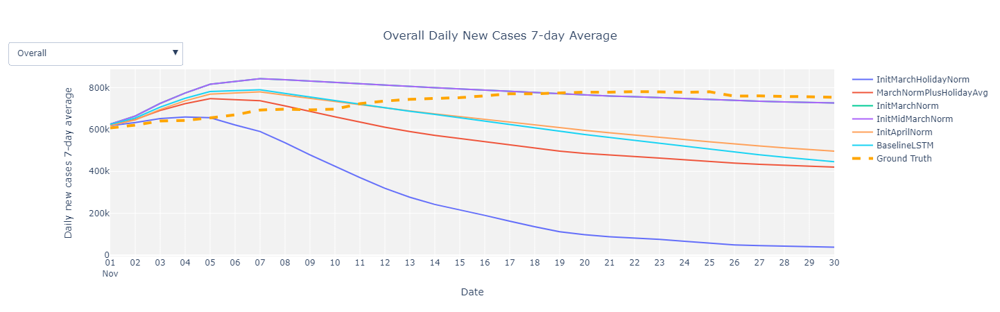

In [277]:
import plotly.graph_objects as go

fig = go.Figure(layout=dict(title=dict(text=f"{DEFAULT_GEO} Daily New Cases 7-day Average ",
                                       y=0.9,
                                       x=0.5,
                                       xanchor='center',
                                       yanchor='top'
                                       ),
                             plot_bgcolor='#f2f2f2',
                             xaxis_title="Date",
                             yaxis_title="Daily new cases 7-day average"
                             ))

# Keep track of trace visibility by geo ID name
geoid_plot_names = []

all_df = ranking_df.groupby(["PredictorName", "Date"])[["GeoID", "PredictorName", "PredictedDailyNewCases7DMA"]].sum(). \
    sort_values(by=["PredictorName", "Date"]).reset_index()

# Add 1 trace per predictor, for all geos
for predictor_name in predictor_names:
    all_geo_df = all_df[all_df.PredictorName == predictor_name]
    fig.add_trace(go.Scatter(x=all_geo_df.Date,
                             y=all_geo_df.PredictedDailyNewCases7DMA,
                             name=predictor_name,
                             visible=(ALL_GEO == DEFAULT_GEO))
                 )
    geoid_plot_names.append(ALL_GEO)

# Add 1 trace per predictor, per geo id
for predictor_name in predictor_names:
    for geoid_name in geoid_names:
        pred_geoid_df = ranking_df[(ranking_df.GeoID == geoid_name) &
                                   (ranking_df.PredictorName == predictor_name)]
        fig.add_trace(go.Scatter(x=pred_geoid_df.Date,
                                 y=pred_geoid_df.PredictedDailyNewCases7DMA,
                                 name=predictor_name,
                                 visible=(geoid_name == DEFAULT_GEO))
                     )
        geoid_plot_names.append(geoid_name)

# For each geo
# Add 1 trace for the true number of cases
for geoid_name in geoid_names:
    # Only plot data that is known, for ground truth
    last_known_date = actual_df[actual_df.ActualDailyNewCases7DMA.notnull()].Date.max()
    geo_actual_df = actual_df[(actual_df.GeoID == geoid_name) &
                                  (actual_df.Date >= start_date)]
    fig.add_trace(go.Scatter(x=geo_actual_df[geo_actual_df.Date <= last_known_date].Date,
                             y=geo_actual_df[geo_actual_df.Date <= last_known_date].ActualDailyNewCases7DMA,
                             name="Ground Truth",
                             visible= (geoid_name == DEFAULT_GEO),
                             line=dict(color='orange', width=4, dash='dash'))
                  )
    geoid_plot_names.append(geoid_name)
    
# Add 1 trace for the overall ground truth
overall_actual_df = actual_df[actual_df.Date >= start_date].groupby(["Date"])[["GeoID", "ActualDailyNewCases7DMA"]].sum(). \
    sort_values(by=["Date"]).reset_index()
overall_last_known_date = overall_actual_df[overall_actual_df.ActualDailyNewCases7DMA > 0].Date.max()
fig.add_trace(go.Scatter(x=overall_actual_df[overall_actual_df.Date <= overall_last_known_date].Date,
                         y=overall_actual_df[overall_actual_df.Date <= overall_last_known_date].ActualDailyNewCases7DMA,
                         name="Ground Truth",
                         visible= (ALL_GEO == DEFAULT_GEO),
                         line=dict(color='orange', width=4, dash='dash'))
                  )
geoid_plot_names.append(geoid_name)

# Format x axis
fig.update_xaxes(
dtick="D1",  # Means 1 day
tickformat="%d\n%b")

# Filter
buttons=[]
for geoid_name in ([ALL_GEO] + geoid_names):
    buttons.append(dict(method='update',
                        label=geoid_name,
                        args = [{'visible': [geoid_name==r for r in geoid_plot_names]},
                                {'title': f"{geoid_name} Daily New Cases 7-day Average "}]))
fig.update_layout(showlegend=True,
                  updatemenus=[{"buttons": buttons,
                                "direction": "down",
                                "active": ([ALL_GEO] + geoid_names).index(DEFAULT_GEO),
                                "showactive": True,
                                "x": 0.1,
                                "y": 1.15}])

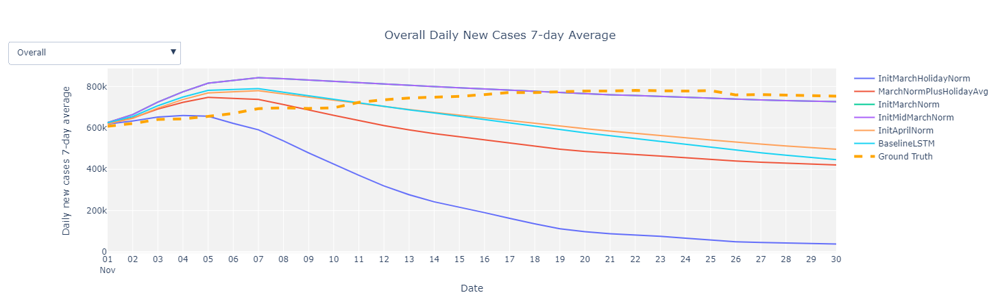

In [280]:
fig.show()

## Rankings: by cumulative 7DMA error per 100K

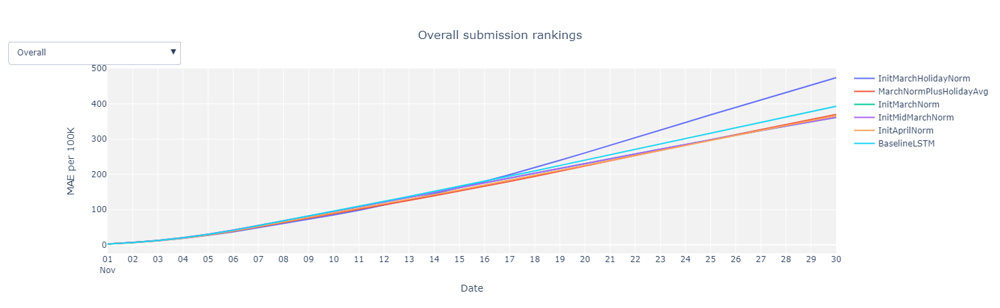

In [279]:
ranking_fig = go.Figure(layout=dict(title=dict(text=f'{DEFAULT_GEO} submission rankings',
                                               y=0.9,
                                               x=0.5,
                                               xanchor='center',
                                               yanchor='top'
                                               ),
                                    plot_bgcolor='#f2f2f2',
                                    xaxis_title="Date",
                                    yaxis_title="MAE per 100K"
                                    ))

# Keep track of trace visibility by geo name
ranking_geoid_plot_names = []

all_df = ranking_df.groupby(["PredictorName", "Date"])[["GeoID", "PredictorName", "Cumul-7DMA-MAE-per-100K"]].mean(). \
    sort_values(by=["PredictorName", "Date"]).reset_index()

# Add 1 trace per predictor, for all geos
for predictor_name in predictor_names:
    ranking_geoid_df = all_df[all_df.PredictorName == predictor_name]
    ranking_fig.add_trace(go.Scatter(x=ranking_geoid_df.Date,
                             y=ranking_geoid_df['Cumul-7DMA-MAE-per-100K'],
                             name=predictor_name,
                             visible=(ALL_GEO == DEFAULT_GEO))
                 )
    ranking_geoid_plot_names.append(ALL_GEO)


# Add 1 trace per predictor, per country
for predictor_name in predictor_names:
    for geoid_name in geoid_names:
        ranking_geoid_df = ranking_df[(ranking_df.GeoID == geoid_name) &
                                        (ranking_df.PredictorName == predictor_name)]
        ranking_fig.add_trace(go.Scatter(x=ranking_geoid_df.Date,
                                 y=ranking_geoid_df['Cumul-7DMA-MAE-per-100K'],
                                 name=predictor_name,
                                 visible= (geoid_name == DEFAULT_GEO))
                     )
        ranking_geoid_plot_names.append(geoid_name)

# Format x axis
ranking_fig.update_xaxes(
dtick="D1",  # Means 1 day
tickformat="%d\n%b")

# Filter
buttons=[]
for geoid_name in ([ALL_GEO] + geoid_names):
    buttons.append(dict(method='update',
                        label=geoid_name,
                        args = [{'visible': [geoid_name==r for r in ranking_geoid_plot_names]},
                                {'title': f'{geoid_name} submission rankings'}]))
ranking_fig.update_layout(showlegend=True,
                          updatemenus=[{"buttons": buttons,
                                        "direction": "down",
                                        "active": ([ALL_GEO] + geoid_names).index(DEFAULT_GEO),
                                        "showactive": True,
                                        "x": 0.1,
                                        "y": 1.15}])

ranking_fig.show()